In [1]:
import pandas as pd
from scipy import sparse
from scipy.optimize import line_search
import pylab as plt

import autograd.numpy as np
import matplotlib.pyplot as plt
import networkx as nx

from autograd import grad
from collections import Counter, defaultdict
from itertools import compress
from scipy.io import loadmat
from scipy.optimize import linear_sum_assignment
from scipy.sparse.linalg import svds
from scipy.special import huber
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler  # for normalization
from sklearn.model_selection import train_test_split as tts
from sklearn.metrics import accuracy_score 
from sklearn.utils import shuffle
from time import process_time

import warnings
warnings.simplefilter('ignore')

# Data process

## dataset1

In [ ]:
# from google.colab import files
# files.upload()

In [2]:
test = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/OFDS/svmguide1_test.t', sep=' ', header=None)
test = test.replace(to_replace=r'[1-4]\:', value='', regex=True)
test[1] = pd.to_numeric(test[1])
test[2] = pd.to_numeric(test[2])
test[3] = pd.to_numeric(test[3])
test[4] = pd.to_numeric(test[4])
# modify the lable 0 to -1
test[test[0]==0] = -1

In [3]:
print(test.shape)
test

(4000, 5)


,0,1,2,3,4
0,-1,-1.0000,-1.0000,-1.000000,-1.00000
1,-1,-1.0000,-1.0000,-1.000000,-1.00000
2,-1,-1.0000,-1.0000,-1.000000,-1.00000
3,-1,-1.0000,-1.0000,-1.000000,-1.00000
4,-1,-1.0000,-1.0000,-1.000000,-1.00000
...,...,...,...,...,...
3995,1,19.9903,41.2381,-0.249064,89.86404
3996,1,51.9014,129.9364,0.216849,174.22380
3997,1,19.8090,193.7110,0.128413,166.10760
3998,1,30.5320,189.4370,-0.154067,159.78490


In [4]:
train = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/OFDS/svmguide1_train', sep=' ', header=None)
train = train.replace(to_replace=r'[1-4]\:', value='', regex=True)
train[1] = pd.to_numeric(test[1])
train[2] = pd.to_numeric(test[2])
train[3] = pd.to_numeric(test[3])
train[4] = pd.to_numeric(test[4])
# modify the lable 0 to -1
train[train[0]==0] = -1

In [5]:
print(train.shape)
train

(3089, 5)


,0,1,2,3,4
0,1,-1.0,-1.0,-1.0,-1.0
1,1,-1.0,-1.0,-1.0,-1.0
2,1,-1.0,-1.0,-1.0,-1.0
3,1,-1.0,-1.0,-1.0,-1.0
4,1,-1.0,-1.0,-1.0,-1.0
...,...,...,...,...,...
3084,-1,-1.0,-1.0,-1.0,-1.0
3085,-1,-1.0,-1.0,-1.0,-1.0
3086,-1,-1.0,-1.0,-1.0,-1.0
3087,-1,-1.0,-1.0,-1.0,-1.0


In [6]:
scaler = StandardScaler()
test.iloc[:,1:5] = scaler.fit_transform(test.iloc[:,1:5])
train.iloc[:,1:5] = scaler.fit_transform(train.iloc[:,1:5])
pd.DataFrame(test)

,0,1,2,3,4
0,-1,-0.694029,-0.779030,-0.959764,-0.963407
1,-1,-0.694029,-0.779030,-0.959764,-0.963407
2,-1,-0.694029,-0.779030,-0.959764,-0.963407
3,-1,-0.694029,-0.779030,-0.959764,-0.963407
4,-1,-0.694029,-0.779030,-0.959764,-0.963407
...,...,...,...,...,...
3995,1,-0.064131,-0.370080,0.454635,0.366983
3996,1,0.893490,0.488697,1.332189,1.602140
3997,1,-0.069571,1.106163,1.165619,1.483306
3998,1,0.252215,1.064782,0.633562,1.390732


In [7]:
test_y = test[0].to_numpy()
test_x = test.iloc[:,1:].to_numpy()
# print('test_x:', test_x)
# print('test_y:', test_y)

train_y = train[0].to_numpy()
train_x = train.iloc[:,1:].to_numpy()
# print('train_x:', train_x)
# print('train_y:', train_y)

## dataset2

In [8]:
data = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/OFDS/splice_scale.csv', sep=' ', header=None)

In [9]:
data = data.replace(to_replace=r'\d+(:|-)', value='', regex=True)
for i in range(len(data.columns)):
  data[i] = pd.to_numeric(data[i])

In [10]:
data = data.dropna(axis=1)
data

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60
0,1,-0.333333,-1.000000,-0.333333,-1.000000,-0.333333,-1.000000,-0.333333,0.333333,0.333333,0.333333,0.333333,-1.000000,-0.333333,-1.000000,0.333333,1.000000,-0.333333,-1.000000,-0.333333,-0.333333,-0.333333,-1.000000,-1.000000,-0.333333,0.333333,-1.000000,1.000000,-0.333333,-0.333333,-1.000000,1.000000,-0.333333,-0.333333,-1.000000,1.000000,-0.333333,-0.333333,-1.000000,-0.333333,-1.000000,-1.000000,-0.333333,-0.333333,-1.000000,1.000000,-0.333333,0.333333,0.333333,1.000000,0.333333,-0.333333,0.333333,1.000000,-0.333333,-0.333333,-0.333333,-0.333333,-1.000000,0.333333,1.000000
1,1,-1.000000,0.333333,0.333333,1.000000,-0.333333,-1.000000,-0.333333,-0.333333,1.000000,0.333333,-0.333333,-0.333333,-0.333333,-1.000000,-0.333333,1.000000,1.000000,0.333333,-0.333333,-1.000000,-0.333333,-1.000000,0.333333,0.333333,-1.000000,-0.333333,0.333333,0.333333,1.000000,-0.333333,-1.000000,0.333333,0.333333,-1.000000,-1.000000,0.333333,-1.000000,1.000000,-0.333333,-0.333333,1.000000,-0.333333,-1.000000,-1.000000,-1.000000,0.333333,0.333333,0.333333,0.333333,-1.000000,1.000000,0.333333,1.000000,1.000000,1.000000,-1.000000,0.333333,1.000000,-1.000000,-1.000000
2,1,-1.000000,1.000000,-1.000000,1.000000,1.000000,1.000000,1.000000,-1.000000,-1.000000,-0.333333,-1.000000,1.000000,-0.333333,-0.333333,-1.000000,0.333333,1.000000,-0.333333,-0.333333,-0.333333,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,0.333333,-1.000000,1.000000,0.333333,-1.000000,-1.000000,0.333333,1.000000,0.333333,0.333333,1.000000,-0.333333,-1.000000,-1.000000,-0.333333,1.000000,1.000000,-1.000000,-0.333333,-1.000000,-1.000000,-1.000000,1.000000,-1.000000,-1.000000,-0.333333,-1.000000,-1.000000,1.000000,-0.333333,-0.333333,1.000000,1.000000,1.000000,-0.333333
3,-1,-1.000000,-1.000000,1.000000,-1.000000,-1.000000,0.333333,0.333333,1.000000,1.000000,0.333333,1.000000,-0.333333,0.333333,1.000000,-0.333333,-0.333333,0.333333,0.333333,0.333333,0.333333,1.000000,0.333333,1.000000,-0.333333,0.333333,0.333333,1.000000,1.000000,-1.000000,-0.333333,-0.333333,-1.000000,-1.000000,1.000000,0.333333,-1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,-1.000000,-1.000000,1.000000,-1.000000,-1.000000,1.000000,-0.333333,-0.333333,-1.000000,0.333333,0.333333,1.000000,-1.000000,0.333333,0.333333,1.000000,-0.333333,-0.333333,-1.000000
4,-1,1.000000,0.333333,1.000000,1.000000,0.333333,-1.000000,-1.000000,1.000000,1.000000,1.000000,-1.000000,-1.000000,0.333333,1.000000,1.000000,1.000000,0.333333,-1.000000,0.333333,-1.000000,1.000000,1.000000,1.000000,0.333333,1.000000,1.000000,1.000000,0.333333,-1.000000,-0.333333,-0.333333,-1.000000,-1.000000,1.000000,-1.000000,-1.000000,0.333333,-1.000000,1.000000,1.000000,-0.333333,0.333333,0.333333,-1.000000,-1.000000,-1.000000,0.333333,-0.333333,1.000000,0.333333,-1.000000,0.333333,-0.333333,-1.000000,1.000000,-0.333333,-1.000000,-1.000000,1.000000,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,1,-1.000000,-0.333333,-0.333333,1.000000,-0.333333,-0.333333,0.333333,0.333333,-1.000000,0.333333,0.333333,-1.000000,-1.000000,0.333333,-1.000000,-0.333333,0.333333,-0.333333,-1.000000,-0.333333,0.333333,1.000000,-0.333333,-0.333333,1.000000,-0.333333,0.333333,-1.000000,-0.333333,-1.000000,-0.333333,0.333333,-0.333333,-0.333333,0.333333,-1.000000,-1.000000,-0.333333,-1.000000,-0.333333,0.333333,-0.333333,-1.000000,-0.333333,-1.000000,1.000000,1.000000,1.000000,0.333333,-0.333333,-0.333333,-1.000000,-0.333333,0.333333,1.000000,0.333333,1.000000,-0.333333,-0.333333,0.333333
996,1,-0.333333,-1.000000,-0.333333,0.333333,1.000000,0.333333,-1.000000,1.000000,1.000000,1.000000,1.000000,1.000

In [11]:
data_y = data[0].to_numpy()
data_x = data.iloc[:,1:].to_numpy()
# print('test_x:', test_x)
# print('test_y:', test_y)

In [12]:
def segment_search(f, grad_f, x, y, tol=1e-6, stepsize=True):
    
    '''
    Minimizes f over [x, y], i.e., f(x+gamma*(y-x)) as a function of scalar gamma in [0,1]
    '''
    
    # restrict segment of search to [x, y]
    d = (y-x).copy()
    left, right = x.copy(), y.copy()
    
    # if the minimum is at an endpoint
    if np.dot(d, grad_f(x))*np.dot(d, grad_f(y)) >= 0:
        if f(y) <= f(x):
            return y, 1
        else:
            return x, 0
    
    # apply golden-section method to segment
    gold = (1+np.sqrt(5))/2
    improv = np.inf
    while improv > tol:
        old_left, old_right = left, right
        new = left+(right-left)/(1+gold)
        probe = new+(right-new)/2
        if f(probe) <= f(new):
            left, right = new, right
        else:
            left, right = left, probe
        improv = np.linalg.norm(f(right)-f(old_right))+np.linalg.norm(f(left)-f(old_left))
    x_min = (left+right)/2
    
    # compute step size gamma
    gamma = 0
    if stepsize == True:
        for i in range(len(d)):
            if d[i] != 0:
                gamma = (x_min[i]-x[i])/d[i]
                break
                
    return x_min, gamma

# FW

In [13]:
# def fw(f, grad_f, x, step, gamma, f_tol, time_tol=np.inf, max_iters=20000):
    
#     # f: loss function
#     # grad_f: derivative of loss function
#     # x: starting point or sth like feasible points set(not sure)
#     # f_tol: toleration of different
#     # time_tol: sum of time
#     # gamma: fixed or adaptive stepsize
#     # max_iters: the maximum of iterations(choose this to stop loop or choose time_tol)
    
#     values, times, iters, oracles, gaps = [f(x)], [0], 0, [0], []
#     f_improv = np.inf
    
#     while f_improv > f_tol and np.sum(times) < time_tol:

#         f_old = f(x)
#         start = process_time()
        
#         grad_f_x = grad_f(x)   
#         # xk_hat = Argmin ∇f(xk).T*(x-xk),x∈C
#         v = lmo(grad_f_x) 
        
#         t1 = process_time()
#         gaps.append(np.dot(grad_f_x, x-v))
#         t2 = process_time()

#         d_fw = v - x # feasible direction

#         if step == 'l1-ball': # Frank-Wolfe method for unit simplex
#             gamma = 2/(len(values)+1)
#             x = (1 - gamma) * x + gamma * v
#             # x = x + gamma * d_fw
#         elif step == 'L':
#             gamma = min(np.dot(grad_f_x, x-v)/(L*np.linalg.norm(x-v)**2), 1)
#             # x = (1 - gamma) * x + gamma * v
#             x = x + gamma * d_fw
#         elif step == 'ls':
#             x, gamma = segment_search(f, grad_f, x, v)
#         elif step == 'fixed stepsize':
#           x = x + gamma * d_fw 
#         else:
#           gamma = min(-np.dot(d, grad_f_x)/np.dot(d, (np.dot(step, d))), 1)
#           x = x + gamma * d_fw

#         end = process_time()
#         values.append(f(x))
#         times.append(end-start+t1-t2)
#         oracles.append(1)
#         f_improv = f_old-f(x)
#         iters += 1
    
#     print(f'running time:{np.sum(times)})')
#     print(f'function value: {values[-1]}')
#     return x, values, times, oracles, gaps

def fw(f, grad_f, L, x, step='ls', f_tol=1e-6, time_tol=np.inf, max_iters=1000):
    
    values, times, oracles, gaps, iters = [f(x)], [0], [0], [], 0
    f_improv = np.inf
    # while f_improv > f_tol and np.sum(times) < time_tol:
    while f_improv > f_tol or iters <= max_iters:

        f_old = f(x)
        start = process_time()
        
        grad_f_x = grad_f(x)        
        v = lmo(grad_f_x)
        
        t1 = process_time()
        gaps.append(np.dot(grad_f_x, x-v))
        t2 = process_time()

        if step == 't':
            gamma = 2/(len(values)+1)
            x = (1-gamma)*x+gamma*v
        elif step == 'L':
            gamma = min(np.dot(grad_f_x, x-v)/(L*np.linalg.norm(x-v)**2), 1)
            x = (1-gamma)*x+gamma*v
        elif step == 'ls':
            x, gamma = segment_search(f, grad_f, x, v)
        else:
            d = v-x
            gamma = min(-np.dot(d, grad_f_x)/np.dot(d, (np.dot(step, d))), 1)
            x = x+gamma*d
        
        end = process_time()
        values.append(f(x))
        times.append(end-start+t1-t2)
        oracles.append(1)
        f_improv = f_old-f(x)
        iters += 1

    print(f'f_improv:{f_improv}')
    print(f'running time:{np.sum(times)}')
    print(f'function value: {values[-1]}')    
    return x, values, times, oracles, gaps

# AFW

In [14]:
def afw(f, grad_f, L, x, step, gamma, f_tol=1e-6, time_tol=np.inf, max_iters=20000):

    # f: loss function
    # grad_f: derivative of loss function
    # x: starting point or sth like feasible points set(not sure)
    # f_tol: toleration of different
    # time_tol: sum of time
    # gamma: fixed or adaptive stepsize
    # max_iters: the maximum of iterations(choose this to stop loop or choose time_tol)
    
    values, times, iters, oracles, gaps = [f(x)], [0], 0, [0], []
    f_improv = np.inf 
    S, alpha = [x.copy()], [1]
    
    while f_improv > f_tol or iters <= max_iters:
    # while f_improv > f_tol and np.sum(times) < time_tol:
        
        f_old = f(x)        
        start = process_time()
                
        grad_f_x = grad_f(x)
        # Set xkˆFW = Argmin ∇f(xk).T*(x-xk),x∈C
        v = lmo(grad_f_x)
        
        t1 = process_time()
        gaps.append(np.dot(grad_f_x, x-v))
        t2 = process_time()
        
        # Away-step direction points away from the worst vertex (i.e.,the one
        # with highest value of the linearized function) describing the current iterate.
        # Set xkˆAS = Argmax ∇f(xk).T*(x-xk),x∈Sk
        i_max = np.argmax(np.dot(S, grad_f_x))
        a = S[i_max]

        d_fw = v-x
        d_as = x-a
        
        if np.dot(grad_f_x, d_fw) <= np.dot(grad_f_x, d_as):
            if step == 't':
                gamma = 2/(len(values)+1)
                x = (1-gamma)*x+gamma*v
                # x = x + gamma * d_fw
            elif step == 'L':
                gamma = min(np.dot(grad_f_x, x-v)/(L*np.linalg.norm(x-v)**2), 1)
                # x = (1-gamma)*x+gamma*v
                x = x + gamma * d_fw
            elif step == 'ls':
                # result = line_search(f, grad_f, x, v)
                # gamma, x = result[0], result[1]
                x, gamma = segment_search(f, grad_f, x, v)
            elif step == 'fixed stepsize':
                d = d_fw # feasible direction
                x = x + gamma * d_fw
            else:
                gamma = min(-np.dot(d, grad_f_x)/np.dot(d, (np.dot(step, d))), 1)
                x = x + gamma * d_fw
            S.append(v)
            alpha = list((1-gamma)*np.array(alpha))+[gamma]
        
        else:
            gamma_max = alpha[i_max]/(1-min(alpha[i_max], 0.99999))
            if step == 'l1-ball': # for l1-ball sets
                gamma = 2/(len(values)+1)
                # x = (1-gamma)*x+gamma*v
                x = x + gamma * d_fw
                alpha = list((1+gamma)*np.array(alpha))
                alpha[i_max] -= gamma
                if gamma == gamma_max:
                    del alpha[i_max]
                    del S[i_max]
            elif step == 'L':
                gamma = min(np.dot(grad_f_x, a-x)/(L*np.linalg.norm(a-x)**2), gamma_max)
                # x = (1+gamma)*x-gamma*a
                x = x + gamma * d_as
                alpha = list((1+gamma)*np.array(alpha))
                alpha[i_max] -= gamma
                if gamma == gamma_max:
                    del alpha[i_max]
                    del S[i_max]
            elif step == 'ls':
                # result = line_search(f, grad_f, x, (1+gamma_max)*x-gamma_max*a)
                # gamma, x = result[0], result[1]
                x, gamma = segment_search(f, grad_f, x, (1+gamma_max)*x-gamma_max*a)
                alpha = list((1+gamma*gamma_max)*np.array(alpha))
                alpha[i_max] -= gamma*gamma_max
                if gamma == 1:
                    del alpha[i_max]
                    del S[i_max]
            else:
                gamma = min(-np.dot(d, grad_f_x)/np.dot(d, (np.dot(step, d))), gamma_max)
                x = x + gamma * d_as
                alpha = list((1+gamma)*np.array(alpha))
                alpha[i_max] -= gamma
                if gamma == gamma_max:
                    del alpha[i_max]
                    del S[i_max]
        iters += 1            
        end = process_time()
        values.append(f(x))
        times.append(end-start+t1-t2)
        oracles.append(2)
        f_improv = f_old-f(x)

    print(f'f_improv:{f_improv}')
    print(f'running time:np.{sum(times)}')
    print(f'function value: {values[-1]}')
    return x, values, times, oracles, gaps

# PFW

In [15]:
def pfw(f, grad_f, L, x, step, gamma, f_tol=1e-6, time_tol=np.inf, max_iters=20000):

    # f: loss function
    # grad_f: derivative of loss function
    # x: starting point or sth like feasible points set(not sure)
    # f_tol: toleration of different
    # time_tol: sum of time
    # gamma: fixed or adaptive stepsize
    # max_iters: the maximum of iterations(choose this to stop loop or choose time_tol)
    
    values, times, iters, oracles, gaps = [f(x)], [0], 0, [0], []
    f_improv = np.inf 
    S, alpha = [x.copy()], [1]
    
    while f_improv > f_tol or iters <= max_iters:
    # while f_improv > f_tol and np.sum(times) < time_tol:
        
        f_old = f(x)        
        start = process_time()
                
        grad_f_x = grad_f(x)
        # Set xkˆFW = Argmin ∇f(xk).T*(x-xk),x∈C
        v = lmo(grad_f_x)
        
        t1 = process_time()
        gaps.append(np.dot(grad_f_x, x-v))
        t2 = process_time()
        
        # Away-step direction points away from the worst vertex (i.e.,the one
        # with highest value of the linearized function) describing the current iterate.
        # Set xkˆAS = Argmax ∇f(xk).T*(x-xk),x∈Sk
        i_max = np.argmax(np.dot(S, grad_f_x))
        a = S[i_max]

        # d_fw = v - x
        # d_as = x - a
        # d_pfw = d_fw + d_as
        d_pfw = v - a     
        
        if step == 't': # Frank-Wolfe method for unit simplex
            gamma = 2/(len(values)+1)
            # x = (1 - gamma) * x + gamma * v
            x = x + gamma * d_pfw
        elif step == 'L':
            gamma = min(np.dot(grad_f_x, x-v)/(L*np.linalg.norm(x-v)**2), 1)
            # x = (1 - gamma) * x + gamma * v
            x = x + gamma * d_pfw
        elif step == 'ls':
            x, gamma = segment_search(f, grad_f, x, v)
        elif step == 'fixed stepsize':
          x = x + gamma * d_pfw 
        else:
          gamma = min(-np.dot(d, grad_f_x)/np.dot(d, (np.dot(step, d))), 1)
          x = x + gamma * d_pfw
        S.append(v)
        alpha = list((1-gamma)*np.array(alpha))+[gamma]
                    
        end = process_time()
        values.append(f(x))
        times.append(end-start+t1-t2)
        oracles.append(2)
        f_improv = f_old-f(x)
        iters += 1

    print(f'f_improv:{f_improv}')
    print(f'running time:np.{sum(times)}')
    print(f'function value: {values[-1]}')
    return x, values, times, oracles, gaps

# Sparse signal recovery

In [ ]:
m, n, sigma = 200, 500, 0.05

x_star = np.random.randn(n)
A = np.random.randn(m, n)
y = np.dot(A, x_star)+sigma*np.random.randn(m)

f = lambda z: np.linalg.norm(y-np.dot(A, z[:n]-z[n:]), 2)**2
grad_f = grad(f)
L = 0 # not used

# l1-ball's Feasible set
tau = np.linalg.norm(x_star, 1)
V = tau * np.identity(2*n)
x = V[np.random.randint(len(V))].copy()

lmo = lambda g: V[np.argmin(g)]

In [ ]:
gamma, f_tol, time_tol, max_iters, step = 1e-4, 1e-6, 50, 25000, 'l1-ball'
# x, values, times, oracles, gaps = fw(f, grad_f, x, step=step, gamma=gamma, f_tol=f_tol, time_tol=time_tol, max_iters=max_iters)
x, values, times, oracles, gaps = fw(f, grad_f, L, x, step='t', f_tol=1e-6, time_tol=60)

In [ ]:
Q = np.matmul(np.transpose(A), A)
Q = 2*np.concatenate((np.concatenate((Q, -Q), axis=1), np.concatenate((-Q, Q), axis=1)), axis=0)
gamma, f_tol, time_tol, align_tol, max_iters, step = 1e-6, 1e-6, 200, 1e-3, 5000, 'L'

# x_A, values_A, times_A, oracles_A, gaps_A = afw(f, grad_f, L, x, step=Q, f_tol=f_tol, time_tol=time_tol, max_iters=max_iters)
x_A, values_A, times_A, oracles_A, gaps_A = afw(f, grad_f, L, x, step='l1-ball', gamma=gamma, f_tol=f_tol, time_tol=time_tol, max_iters=max_iters)

running time:np.sum(times)
function value: values[-1]


In [ ]:
Q = np.matmul(np.transpose(A), A)
Q = 2*np.concatenate((np.concatenate((Q, -Q), axis=1), np.concatenate((-Q, Q), axis=1)), axis=0)
gamma, f_tol, time_tol, align_tol, max_iters, step = 1e-6, 1e-6, 200, 1e-3, 5000, 'L'

# x_A, values_A, times_A, oracles_A, gaps_A = afw(f, grad_f, L, x, step=Q, f_tol=f_tol, time_tol=time_tol, max_iters=max_iters)
x_P, values_P, times_P, oracles_P, gaps_P = pfw(f, grad_f, L, x, step='l1-ball', gamma=gamma, f_tol=f_tol, time_tol=time_tol, max_iters=max_iters)

running time:np.200.08675217299515
function value: 136.19122977446997


In [ ]:
print(len(values))
# print(values_A[-10:-1])
# print(values[5])
# print('times:',np.sum(times))
# print('iters:', len(values_A))

24705


## plot func values

<Figure size 432x288 with 0 Axes>

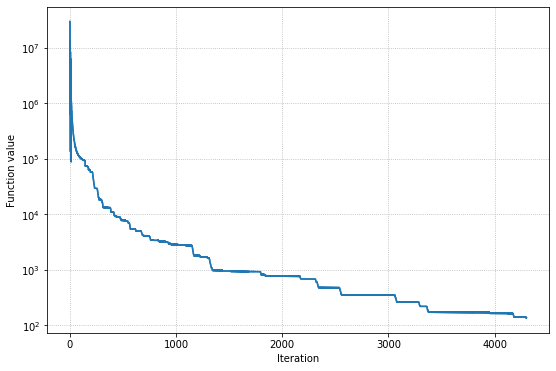

In [ ]:
fig = plt.figure()
plt.figure(figsize=(9, 6))
plt.yscale('log')
plt.ylabel('Function value')
plt.xlabel('Iteration')
plt.tick_params(which='minor', left=False)
plt.grid(linestyle=':')
plt.plot(np.arange(len(values_P)), values_P, color='tab:blue', label='FW')
# plt.plot(values)
# plt.plot(values_A)
plt.plot(values_P)

plt.show()

## plot gaps

<Figure size 432x288 with 0 Axes>

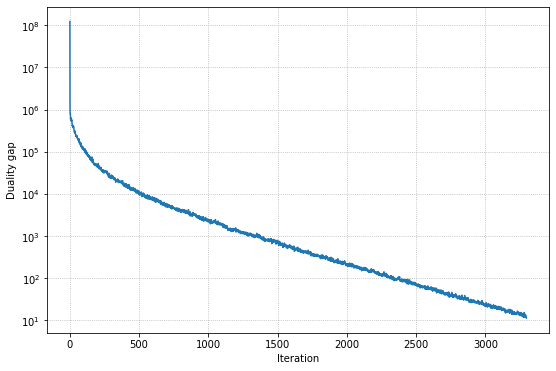

In [ ]:
fig = plt.figure()
plt.figure(figsize=(9, 6))
plt.yscale('log')
plt.ylabel('Duality gap')
plt.xlabel('Iteration')
plt.tick_params(which='minor', left=False)
plt.grid(linestyle=':')
# plt.plot(np.arange(len(values), values, linestyle=styles[alg], color='tab:blue', label='FW')
plt.plot(gaps_A)

# Sparse logistic regression on the Gisette dataset

In [ ]:
from google.colab import files
files.upload()

Saving gisette_data.csv to gisette_data.csv
Saving gisette_labels.csv to gisette_labels.csv


{'gisette_data.csv': b'0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271

In [ ]:
A = pd.read_csv('gisette_data.csv', header=None)
y = pd.read_csv('gisette_labels.csv', header=None)[0].values

scaler = StandardScaler()
A = scaler.fit_transform(A)
m, n = A.shape

f = lambda z: np.sum(np.log(1+np.exp(-y*np.dot(A, z[:n]-z[n:]))))/m
grad_f = grad(f)
L = 0.5

tau = 10
V = tau*np.identity(2*n)
x = V[np.random.randint(len(V))].copy()

lmo = lambda g: V[np.argmin(g)]

## step=L

In [ ]:
gamma, f_tol, time_tol, align_tol, max_iters, step = 1e-6, 1e-6, 80, 1e-3, 500, 'L'
x_A, values_A, times_A, oracles_A, gaps_A = afw(f, grad_f, L, x, step='L', gamma=gamma, f_tol=f_tol, time_tol=time_tol, max_iters=max_iters)
x_P, values_P, times_P, oracles_P, gaps_P = pfw(f, grad_f, L, x, step='L', gamma=gamma, f_tol=f_tol, time_tol=time_tol, max_iters=max_iters)

44.31674592200102
80.0647174250019


## step=ls

In [ ]:
gamma, f_tol, time_tol, align_tol, max_iters, step = 1e-6, 1e-6, 80, 1e-3, 500, 'L'
x_Als, values_Als, times_Als, oracles_Als, gaps_Als = afw(f, grad_f, L, x, step='ls', gamma=gamma, f_tol=f_tol, time_tol=time_tol, max_iters=max_iters)
x_Pls, values_Pls, times_Pls, oracles_Pls, gaps_Pls = pfw(f, grad_f, L, x, step='ls', gamma=gamma, f_tol=f_tol, time_tol=time_tol, max_iters=max_iters)

81.23458487200003
80.12067698200065


## step=fixed step

In [ ]:
gamma, f_tol, time_tol, align_tol, max_iters, step = 1e-5, 1e-6, 200, 1e-3, 500, 'L'
x_Pfs, values_Pfs, times_Pfs, oracles_Pfs, gaps_Pfs = pfw(f, grad_f, L, x, step='L', gamma=gamma, f_tol=f_tol, time_tol=time_tol, max_iters=max_iters)
x_Afs, values_Afs, times_Afs, oracles_Afs, gaps_Afs = afw(f, grad_f, L, x, step='L', gamma=gamma, f_tol=f_tol, time_tol=time_tol, max_iters=max_iters)

## plot func values

In [ ]:
print(values_A[-1])
print(values_P[-1])
# print(values_Als[-1])
# print(values_Pls[-1])

0.11978558009980628
0.11687379086597564


No handles with labels found to put in legend.
No handles with labels found to put in legend.


<Figure size 432x288 with 0 Axes>

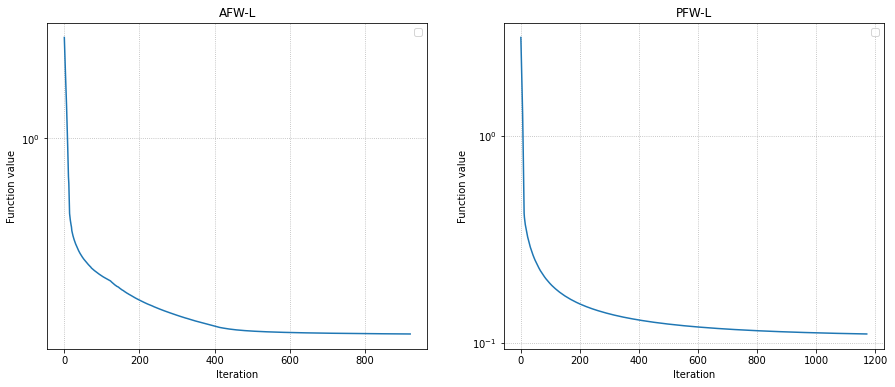

In [ ]:
fig = plt.figure()
plt.figure(figsize=(15, 6))
plt.subplot(1,2,1)
plt.legend()
plt.yscale('log')
plt.ylabel('Function value')
plt.xlabel('Iteration')
plt.tick_params(which='minor', left=False)
plt.grid(linestyle=':')
plt.plot(values_A, label='AFW-L'), plt.title('AFW-L')
# plt.plot(values_Als, label='AFW-ls'), plt.title('AFW-L')
# plt.plot(values_Afs, label='AFW-fs')

plt.subplot(1,2,2)
plt.legend()
plt.yscale('log')
plt.ylabel('Function value')
plt.xlabel('Iteration')
plt.tick_params(which='minor', left=False)
plt.grid(linestyle=':')
plt.plot(values_P, label='PFW-L'), plt.title('PFW-L')
# plt.plot(values_Pls, label='PFW-ls'), plt.title('PFW-L')
plt.show()

# SVM dual problem


$$min_{x_∈\Delta}{\rVert Ax \rVert}^2$$
$$\Delta:=\{x ∈R^n | x \geq 0, ∑_ix_i=1\}, \:\:\: 
A:=\left(\begin{array}{c}Z\\ {{1} \over {\sqrt{C}I_n}}\end{array}\right)∈R^{(d+n)×n}$$     
where the data matrix $Z∈R^{d×n}$ consists of the n columns $Z_i:=y_iX_i$



***Unit Simplex***   
feasible set is   
$$C = \{x \in R^n: e^Tx=1, x\geq0\}=conv(\{e_i, i=1,...,n\})$$  

***Linear Minimization Oracle***:
$$LMO(y) = Argmin_{x∈C}\:(y^Tx),\:C ∈R^n\:is\:a\:convex\:compact$$

In [45]:
X = train_x
y = train_y
# X = data_x
# y = data_y
d, n = X.shape
# weight vectors initialization: (n)
x_star = np.random.random(n) 
x_star /= x_star.sum()
# regularization parameter
C = 0.001
# identity matrix (n * n)
I = np.eye(n)
for i in range(n):
  I[i][i] = 1 / np.sqrt(C)
Z = y.reshape(d,1) * X 
A = np.concatenate((Z, I))
svm_f = lambda z: np.linalg.norm(np.dot(A, z[:n]-z[n:]), 2)**2
grad_f = grad(svm_f)
L = 0 # not used

# tau = 10
# V = tau*np.identity(2*n)
# x = V[np.random.randint(len(V))].copy()

# l1-ball's Feasible set
tau = np.linalg.norm(x_star, 1)
V = tau * np.identity(2*n)
x = V[np.random.randint(len(V))].copy()

lmo = lambda g: V[np.argmin(g)]

In [ ]:
# def svm_f(X, y, weight_vec, reg_par, i_mat):
#   Z = y * X
#   for i in range(n):
#     i_mat[i][i] = 1 / np.sqrt(reg_par)
#   A = np.concatenate((Z, i_mat))
#   result = np.linalg.norm(A * weight_vec)
#   return np.square(result)

## Test FW, AFW and PFW on data1

In [41]:
# gamma, f_tol, time_tol, max_iters, step = 1e-4, 1e-6, 50, 5000, 'l1-ball'
x, values, times, oracles, gaps = fw(svm_f, grad_f, L, x, step='t', f_tol=1e-6, time_tol=60, max_iters=5000)
# x, values, times, oracles, gaps = fw(svm_f, grad_f, x, step=step, gamma=gamma, f_tol=f_tol, time_tol=time_tol, max_iters=max_iters)

f_improv:-1.1099519740820352e-16
running time:6.581540453988282
function value: 3.99840047987561e-05


In [46]:
gamma, f_tol, time_tol, max_iters, step = 1e-4, 1e-6, 50, 5000, 't'
x_a, values_a, times_a, oracles_a, gaps_a = afw(svm_f, grad_f, L, x, step=step, gamma=gamma, f_tol=f_tol, time_tol=time_tol, max_iters=5000)
# x_a, values_a, times_a, oracles_a, gaps_a = afw(svm_f, grad_f, L, x, step='ls', f_tol=f_tol, time_tol=time_tol)

f_improv:-2.2199039481640703e-17
running time:np.208.29616089902765
function value: 3.998400479871171e-05


In [43]:
gamma, f_tol, time_tol, align_tol, max_iters, step = 1e-4, 1e-6, 50, 1e-3, 5000, 't'
x_p, values_p, times_p, oracles_p, gaps_p = pfw(svm_f, grad_f, L, x, step='t', gamma=gamma, f_tol=f_tol, time_tol=time_tol, max_iters=5000)

f_improv:-5.816369524074981e-07
running time:np.208.73394303799864
function value: 0.00016016309204607715


<Figure size 432x288 with 0 Axes>

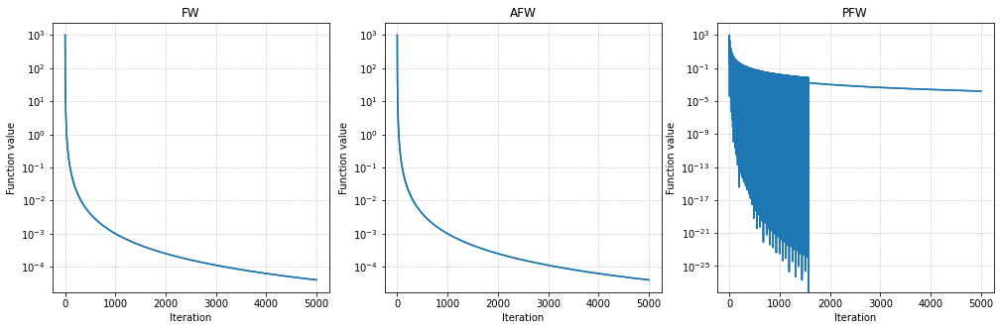

In [47]:
fig = plt.figure()
plt.figure(figsize=(17, 5))

plt.subplot(1,3,1), plt.yscale('log'), plt.ylabel('Function value'), plt.xlabel('Iteration'), plt.title('FW')
plt.tick_params(which='minor', left=False), plt.grid(linestyle=':')
plt.plot(np.arange(len(values)), values, color='tab:blue')
plt.plot(values)

plt.subplot(1,3,2), plt.yscale('log'), plt.ylabel('Function value'), plt.xlabel('Iteration'), plt.title('AFW')
plt.tick_params(which='minor', left=False), plt.grid(linestyle=':')
plt.plot(np.arange(len(values_a)), values_a, color='tab:blue')
plt.plot(values_a)

plt.subplot(1,3,3), plt.yscale('log'), plt.ylabel('Function value'), plt.xlabel('Iteration'), plt.title('PFW')
plt.tick_params(which='minor', left=False), plt.grid(linestyle=':')
plt.plot(np.arange(len(values_p)), values_p, color='tab:blue')
plt.plot(values_p)

plt.show()

<Figure size 432x288 with 0 Axes>

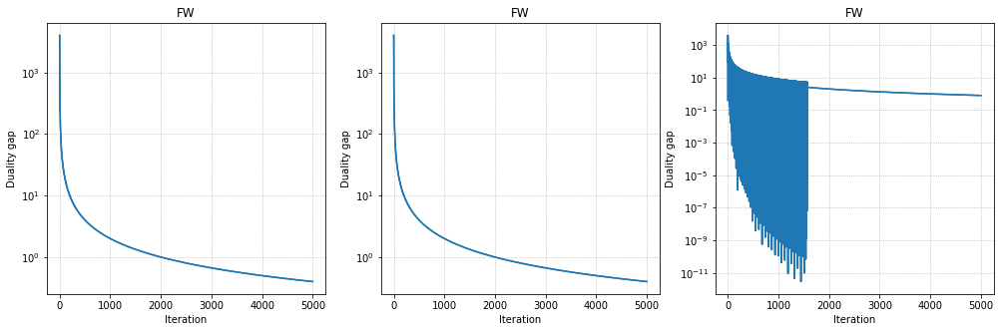

In [48]:
fig = plt.figure()
plt.figure(figsize=(17, 5))

plt.subplot(1,3,1), plt.yscale('log'), plt.ylabel('Duality gap'), plt.xlabel('Iteration'), plt.title('FW')
plt.tick_params(which='minor', left=False), plt.grid(linestyle=':')
plt.plot(np.arange(len(gaps)), gaps, color='tab:blue')
plt.plot(gaps)

plt.subplot(1,3,2), plt.yscale('log'), plt.ylabel('Duality gap'), plt.xlabel('Iteration'), plt.title('FW')
plt.tick_params(which='minor', left=False), plt.grid(linestyle=':')
plt.plot(np.arange(len(gaps_a)), gaps_a, color='tab:blue')
plt.plot(gaps_a)

plt.subplot(1,3,3), plt.yscale('log'), plt.ylabel('Duality gap'), plt.xlabel('Iteration'), plt.title('FW')
plt.tick_params(which='minor', left=False), plt.grid(linestyle=':')
plt.plot(np.arange(len(gaps_p)), gaps_p, color='tab:blue')
plt.plot(gaps_p)

plt.show()

## Test FW, AFW and PFW on data2

In [ ]:
# gamma, f_tol, time_tol, max_iters, step = 1e-4, 1e-6, 50, 5000, 'l1-ball'
x, values, times, oracles, gaps = fw(svm_f, grad_f, L, x, step='t', f_tol=1e-6, time_tol=60, max_iters=5000)
# x, values, times, oracles, gaps = fw(svm_f, grad_f, x, step=step, gamma=gamma, f_tol=f_tol, time_tol=time_tol, max_iters=max_iters)

f_improv:-3.0991919100498144e-16
running time:8.72366384695215
function value: 6.201962962304782e-05


In [ ]:
gamma, f_tol, time_tol, max_iters, step = 1e-4, 1e-6, 50, 5000, 't'
x_a, values_a, times_a, oracles_a, gaps_a = afw(svm_f, grad_f, L, x, step=step, gamma=gamma, f_tol=f_tol, time_tol=time_tol, max_iters=5000)
# x_a, values_a, times_a, oracles_a, gaps_a = afw(svm_f, grad_f, L, x, step='ls', f_tol=f_tol, time_tol=time_tol)

f_improv:-3.4332617044469105e-16
running time:np.213.95902099897285
function value: 6.870140276208943e-05


In [ ]:
gamma, f_tol, time_tol, align_tol, max_iters, step = 1e-4, 1e-6, 50, 1e-3, 5000, 't'
x_p, values_p, times_p, oracles_p, gaps_p = pfw(svm_f, grad_f, L, x, step='t', gamma=gamma, f_tol=f_tol, time_tol=time_tol, max_iters=5000)

f_improv:-4.620130978628652e-06
running time:np.213.6682367360536
function value: 0.0004950352098826989


<Figure size 432x288 with 0 Axes>

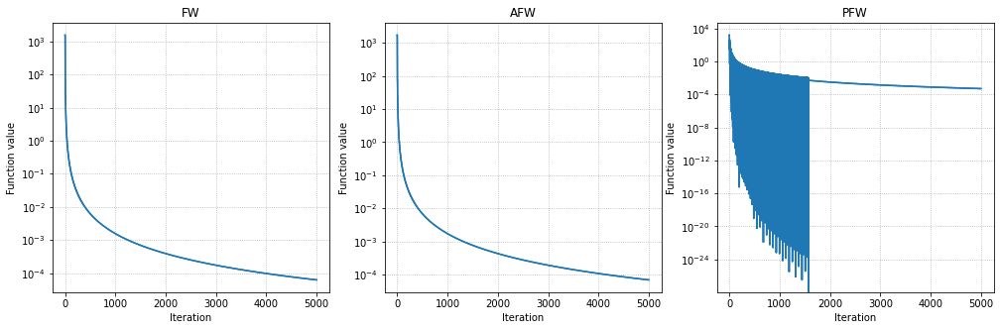

In [ ]:
fig = plt.figure()
plt.figure(figsize=(17, 5))

plt.subplot(1,3,1), plt.yscale('log'), plt.ylabel('Function value'), plt.xlabel('Iteration'), plt.title('FW')
plt.tick_params(which='minor', left=False), plt.grid(linestyle=':')
plt.plot(np.arange(len(values)), values, color='tab:blue')
plt.plot(values)

plt.subplot(1,3,2), plt.yscale('log'), plt.ylabel('Function value'), plt.xlabel('Iteration'), plt.title('AFW')
plt.tick_params(which='minor', left=False), plt.grid(linestyle=':')
plt.plot(np.arange(len(values_a)), values_a, color='tab:blue')
plt.plot(values_a)

plt.subplot(1,3,3), plt.yscale('log'), plt.ylabel('Function value'), plt.xlabel('Iteration'), plt.title('PFW')
plt.tick_params(which='minor', left=False), plt.grid(linestyle=':')
plt.plot(np.arange(len(values_p)), values_p, color='tab:blue')
plt.plot(values_p)

plt.show()

<Figure size 432x288 with 0 Axes>

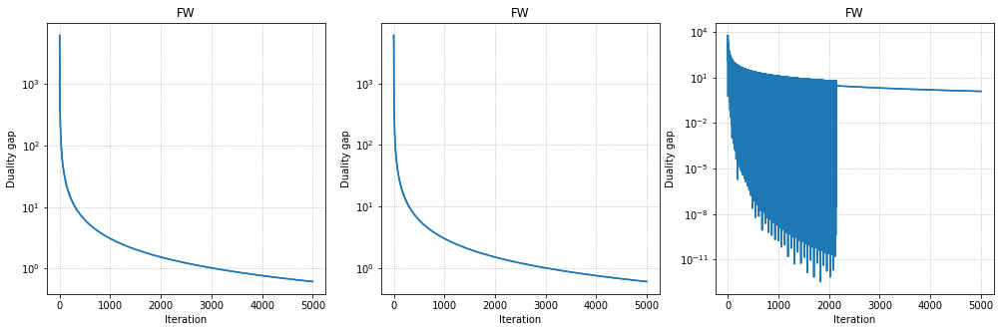

In [25]:
fig = plt.figure()
plt.figure(figsize=(17, 5))

plt.subplot(1,3,1), plt.yscale('log'), plt.ylabel('Duality gap'), plt.xlabel('Iteration'), plt.title('FW')
plt.tick_params(which='minor', left=False), plt.grid(linestyle=':')
plt.plot(np.arange(len(gaps)), gaps, color='tab:blue')
plt.plot(gaps)

plt.subplot(1,3,2), plt.yscale('log'), plt.ylabel('Duality gap'), plt.xlabel('Iteration'), plt.title('FW')
plt.tick_params(which='minor', left=False), plt.grid(linestyle=':')
plt.plot(np.arange(len(gaps_a)), gaps_a, color='tab:blue')
plt.plot(gaps_a)

plt.subplot(1,3,3), plt.yscale('log'), plt.ylabel('Duality gap'), plt.xlabel('Iteration'), plt.title('FW')
plt.tick_params(which='minor', left=False), plt.grid(linestyle=':')
plt.plot(np.arange(len(gaps_p)), gaps_p, color='tab:blue')
plt.plot(gaps_p)

plt.show()